In [2]:
import numpy as np
import json
import matplotlib.pyplot as plt
import os
import re
import scipy.ndimage
import random

In [3]:
%matplotlib inline

In [11]:
files = os.listdir('data')
names = []
for i in files:
    m = re.search('.*json', i)
    if (m <> None) and (i <> 'data.json') and (i <> 'dataBad.json'):
        names.append('data/'+i)

In [5]:
def ED(line1, line2):
    return np.sqrt(np.sum((line1[0]-line2[0])**2)+np.sum((line1[1]-line2[1])**2))

## Подготовка данных

Подбираем референсные кривые для обрабатываемых линий. В дальнейшем по ним будем зашумлять данные для дальнейшего фиттирования.

In [114]:
#создание json'а

#q = dict()
#json.dump(q, open("data/data.json", 'w'))
#q = dict()
#json.dump(q, open("data/dataBad.json", 'w'))

In [12]:
#открытие файла с линиями

output = json.load(open("data/data.json"))
outputBad = json.load(open("data/dataBad.json"))

Всего картинок: 18
Сейчас: 18 ая
Всего линий: 6
Сейчас: 6 ая
Коэффициенты:  [ -1.06386587e-11   3.47537566e-08  -4.74422123e-05   3.46569983e-02
  -1.42937431e+01   3.15281628e+03  -2.89191705e+05]


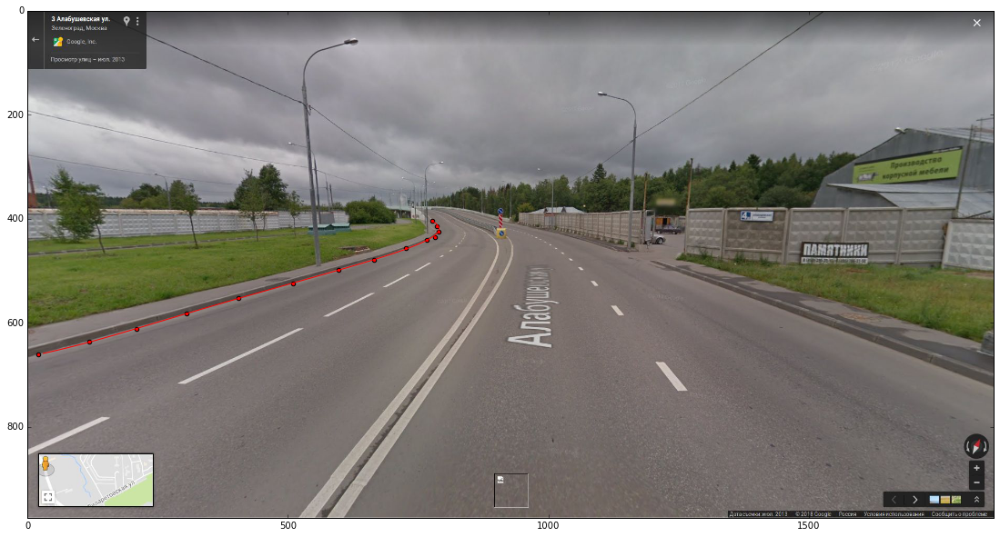

In [24]:
#просмотр линии

PHOTO_NUMBER = 17
LINE_NUMBER = 5

print "Всего картинок:", len(names)
print "Сейчас:", PHOTO_NUMBER+1, "ая"
name = names[PHOTO_NUMBER]

data = json.load(open(name))

X = dict()
points = data[data.keys()[0]]['regions']
for pointKey in points.keys():
    line = points[pointKey]['region_attributes']['line']
    pointCoord = points[pointKey]['shape_attributes']
    if (line not in X):
        X[line] = []
    X[line].append([pointCoord['cx'], pointCoord['cy']])

image = scipy.ndimage.imread(name[:-5]+'.jpeg')
plt.figure(figsize = (25, 10))
plt.xlim((0, image.shape[1]))
plt.ylim((image.shape[0], 0))
plt.imshow(image)

print "Всего линий:", len(X.keys())
print "Сейчас:", LINE_NUMBER+1, "ая"
key = X.keys()[LINE_NUMBER]

line = np.array(X[key])
plt.scatter(line[:,0], line[:,1], c='r')

POWER = 6
c = np.polyfit(line[:,1], line[:,0], POWER, full=True)
print 'Коэффициенты: ', c[0] 

start = int(min(line[:,1]))
stop = int(max(line[:,1]))
x = np.array(xrange(start, stop, (stop-start)/50))

y = np.zeros(x.size)
for j in range(POWER+1):
    y += c[0][j] * x**(POWER-j)

plt.plot(y, x, c='r')

In [25]:
#сохранение линии

toWrite = dict()
toWrite['begin'] = start
toWrite['end'] = stop
toWrite['power'] = POWER
toWrite['coef'] = list(c[0])

if (name not in output):
    output[name] = []
output[name].append(toWrite)

In [309]:
#сохранение плохой линии

if (name not in outputBad):
    outputBad[name] = []
outputBad[name].append([list(i) for i in line])

In [26]:
#запись файла с линиями

json.dump(output, open("data/data.json", "w"))
json.dump(outputBad, open("data/dataBad.json", "w"))

## Работа с данными

In [49]:
data = json.load(open("data/data.json"))

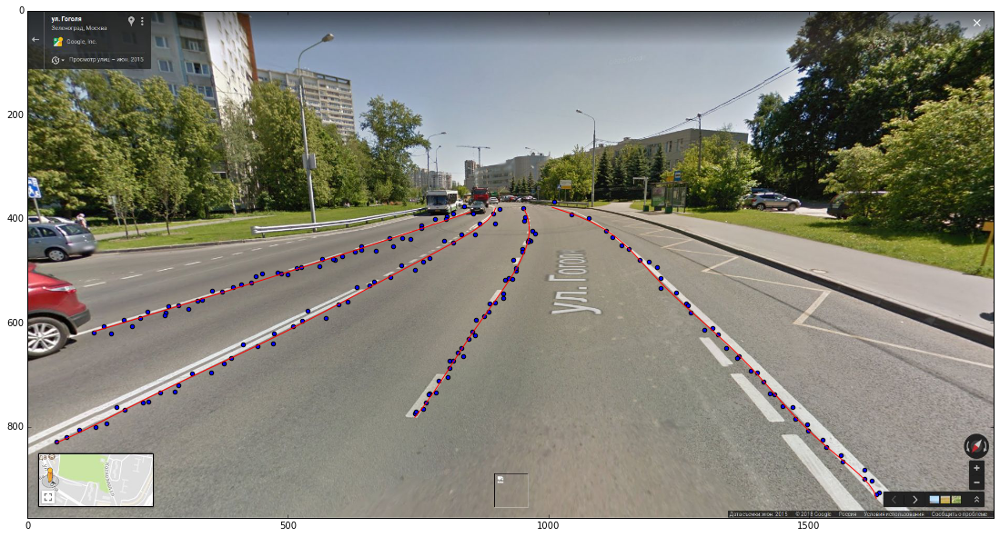

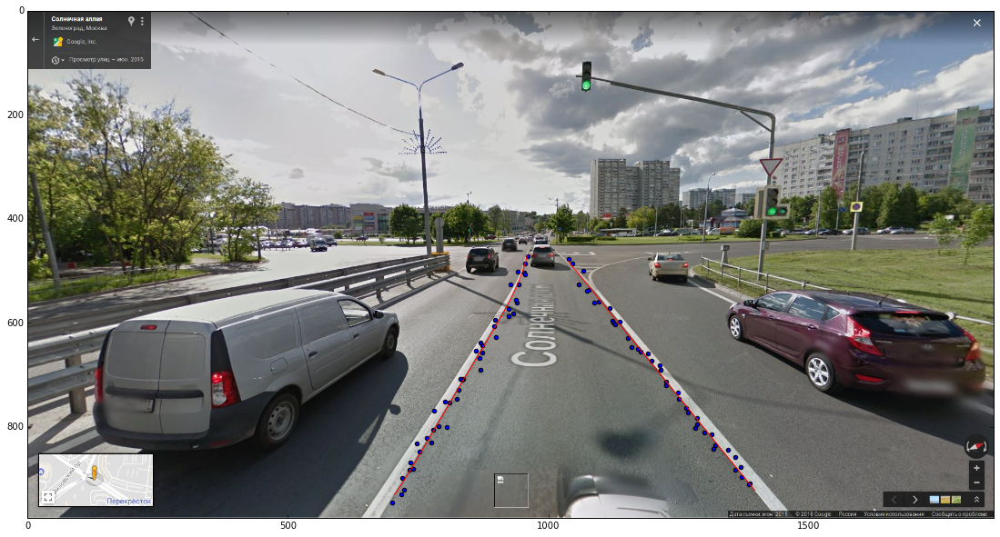

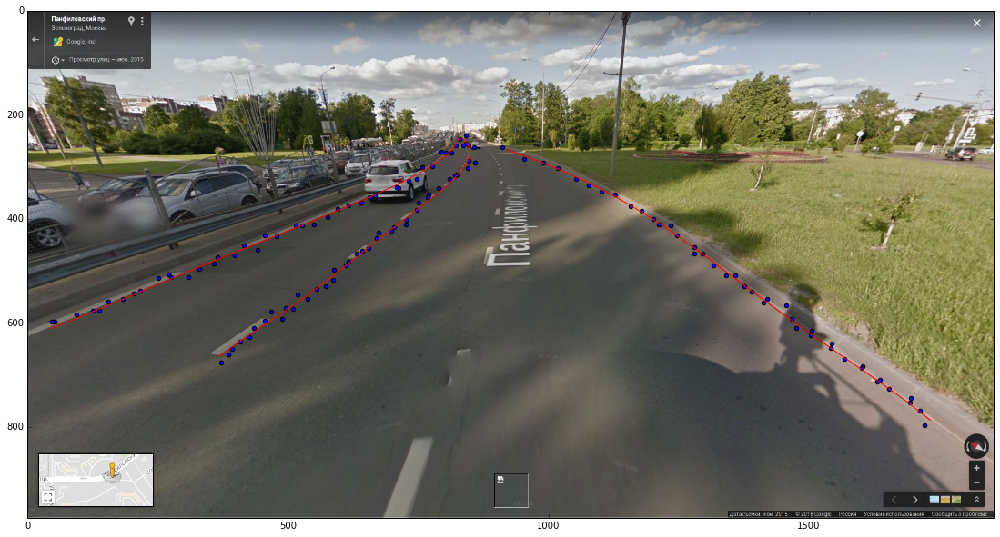

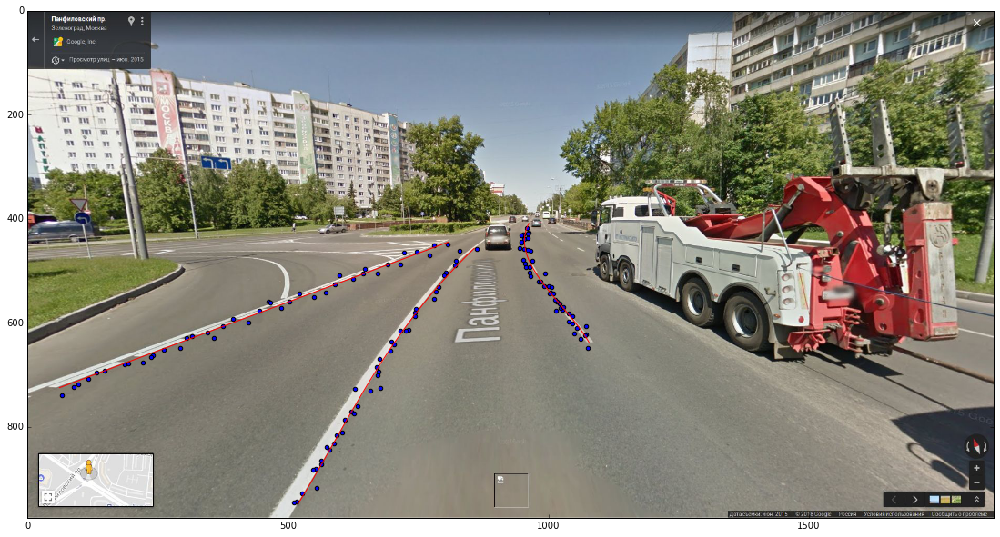

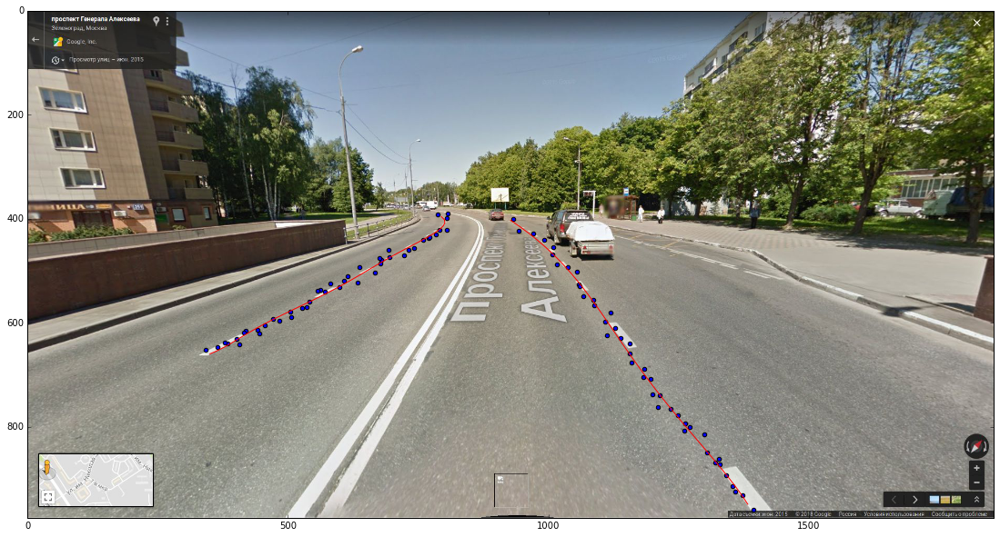

...

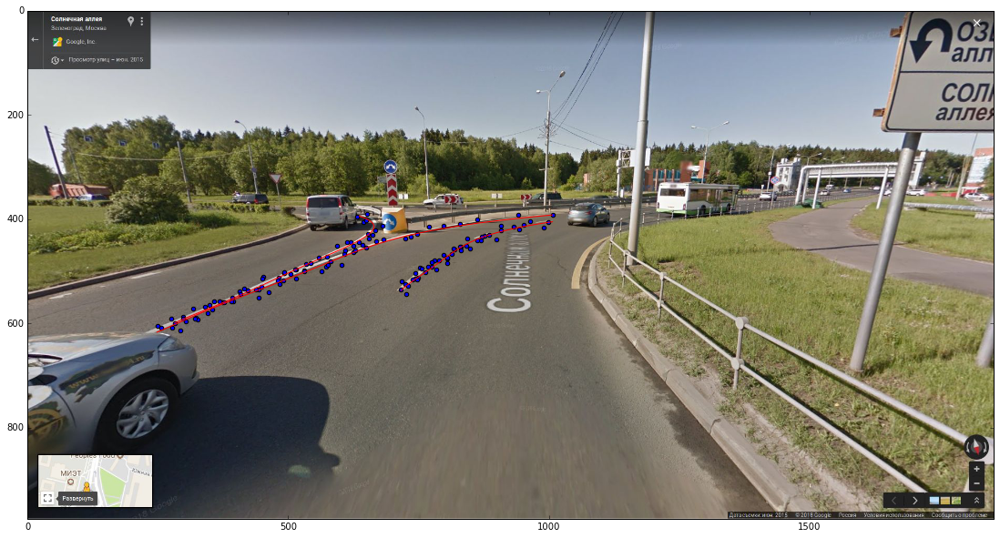

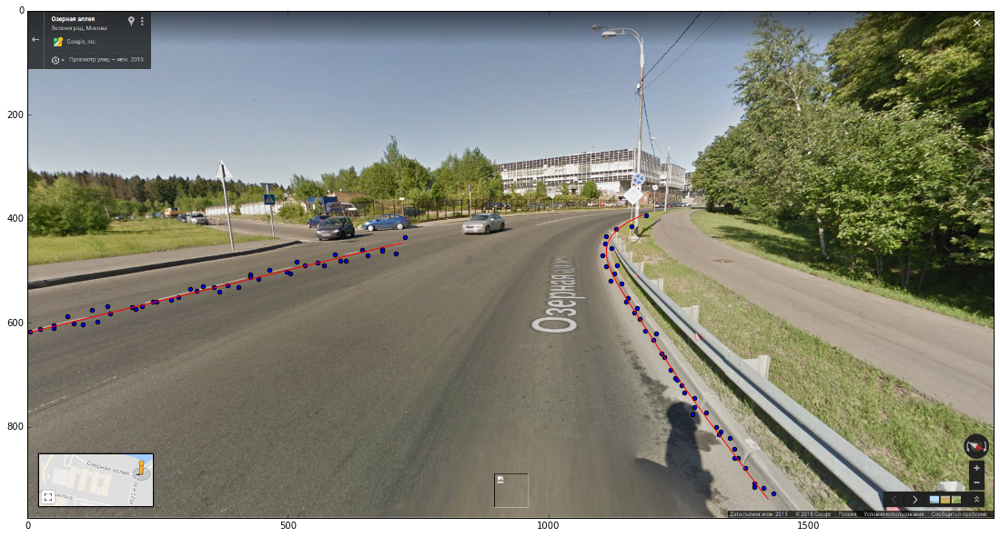

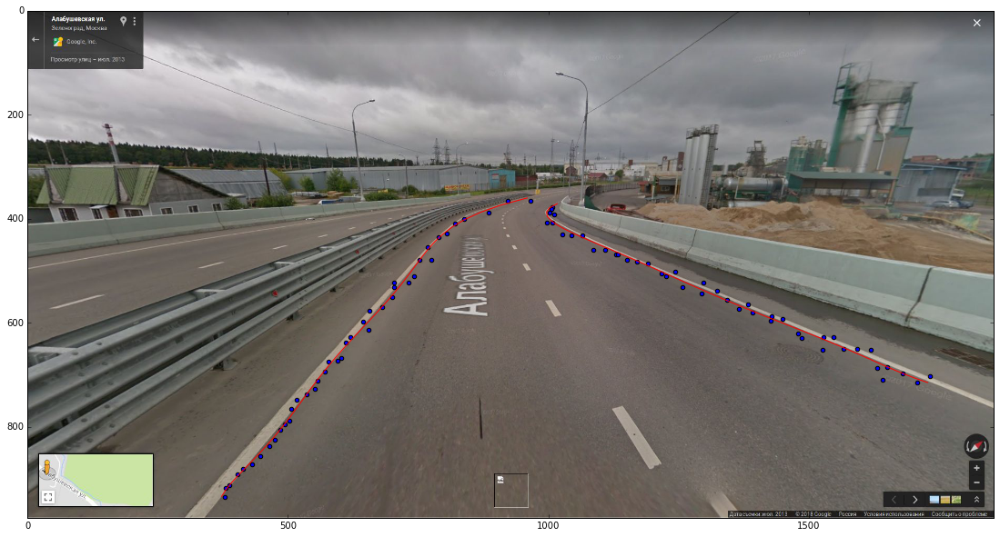

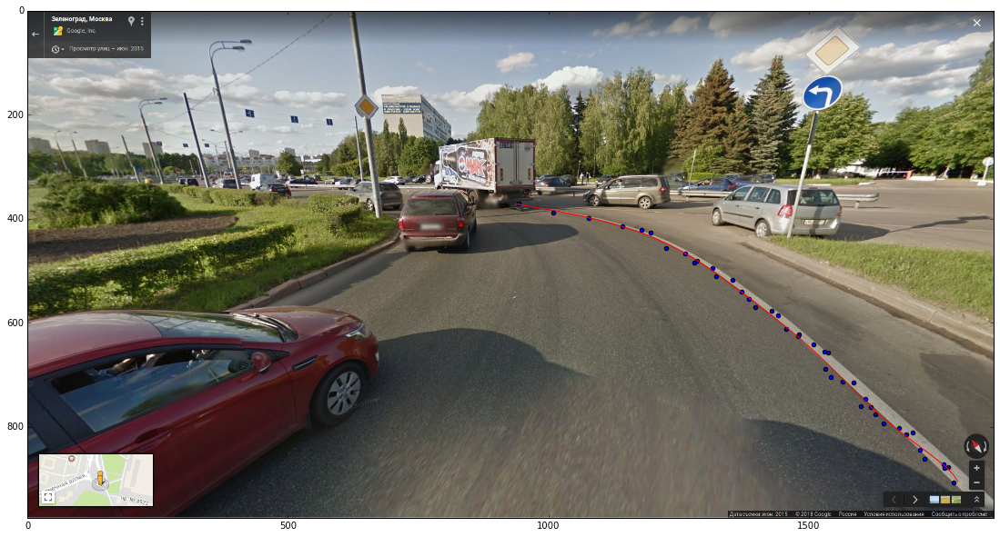

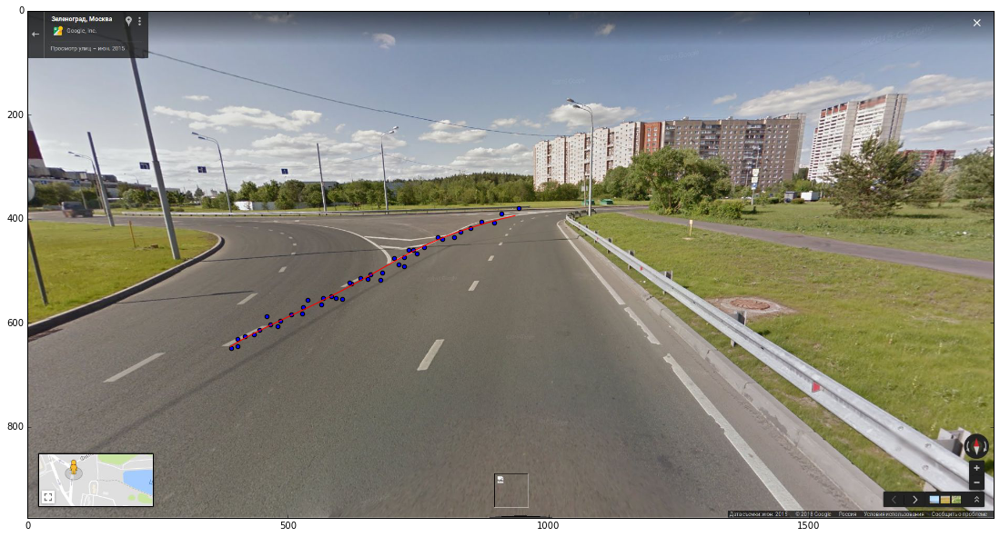

In [52]:
SIGMA = 7
MAX_POWER = 6
coef = []
coef_noise = []
ed = []
ed_noise = []

for name in data:
    #отрисовка картинки
    image = scipy.ndimage.imread(name[:-5]+'.jpeg')
    plt.figure(figsize = (25, 10))
    plt.xlim((0, image.shape[1]))
    plt.ylim((image.shape[0], 0))
    plt.imshow(image)
    
    for line in data[name]:
        start = line['begin']
        stop = line['end']
        power = line['power']
        cRef = line['coef']
        
        #отрисовка референсной линии
        xRef = np.array(range(start, stop, (stop-start)/40))
        yRef = np.zeros(xRef.size)
        for j in range(power+1):
            yRef += cRef[j] * xRef**(power-j)
        plt.plot(yRef, xRef, c='r')
        
        #зашумление линии
        line_noise = [[random.gauss(coordX, SIGMA), random.gauss(coordY, SIGMA)] for coordX, coordY in zip(yRef, xRef)]
        line_noise = np.array(line_noise)
        plt.scatter(line_noise[:,0], line_noise[:,1], c='b')
        
        #фиттирование незашумленной линии
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = np.polyfit(xRef, yRef, power, full=True) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[0][j] * x**(power-j)
            ed_loc.append(ED((xRef,yRef),(x,y)))
            coef_loc.extend(c[0])
        ed.append(ed_loc)
        coef.append(coef_loc)
        
        #фиттирование зашумленной линии
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = np.polyfit(line_noise[:,1], line_noise[:,0], power, full=True) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[0][j] * x**(power-j)
            ed_loc.append(ED((xRef,yRef),(x,y)))
            coef_loc.extend(c[0])
        ed_noise.append(ed_loc)
        coef_noise.append(coef_loc)

Распределение ошибки, при фиттированием многочленом i-ой степени НЕзашумленных данных
1 - min: 0.0 - max: 263.305014952 - mean: 90.0012305646
2 - min: 1.49098889876e-12 - max: 188.281294754 - mean: 57.3622115828
3 - min: 1.40162546881e-12 - max: 131.143246452 - mean: 34.127906708
4 - min: 1.74649034031e-12 - max: 81.1893092931 - mean: 18.4803785988
5 - min: 8.58316802268e-13 - max: 38.828840425 - mean: 8.25704649513
6 - min: 7.45494449382e-13 - max: 4.36630404358e-08 - mean: 2.82329186139e-09


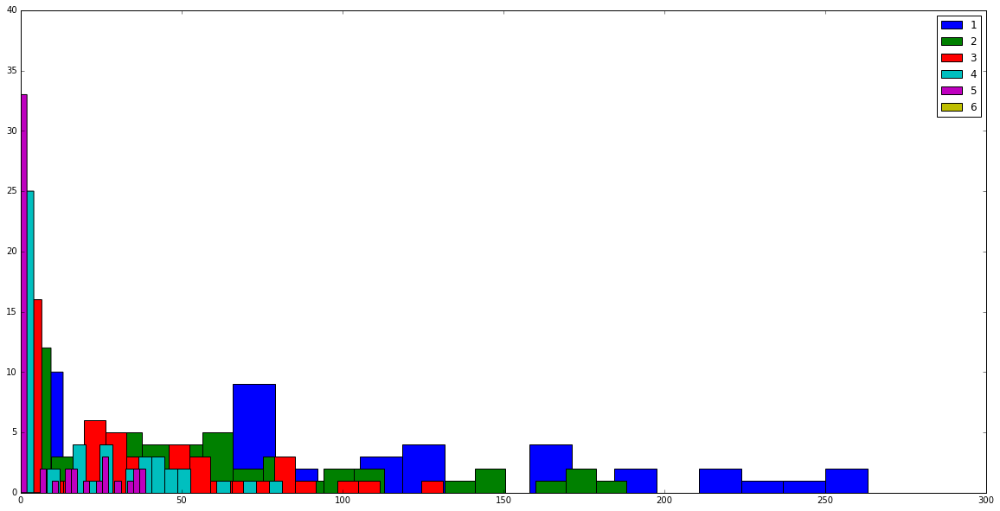

Распределение ошибки, при фиттированием многочленом i-ой степени зашумленных данных
1 - min: 6.37979683237 - max: 263.523765428 - mean: 96.6381314892
2 - min: 7.49540780222 - max: 188.383379916 - mean: 68.6464885809
3 - min: 11.4175800154 - max: 132.684038741 - mean: 51.1339056963
4 - min: 9.98370086693 - max: 89.0213856051 - mean: 43.3452101195
5 - min: 9.97580342453 - max: 91.3105165283 - mean: 39.4301770738
6 - min: 11.1563512707 - max: 90.116265125 - mean: 39.8816821835


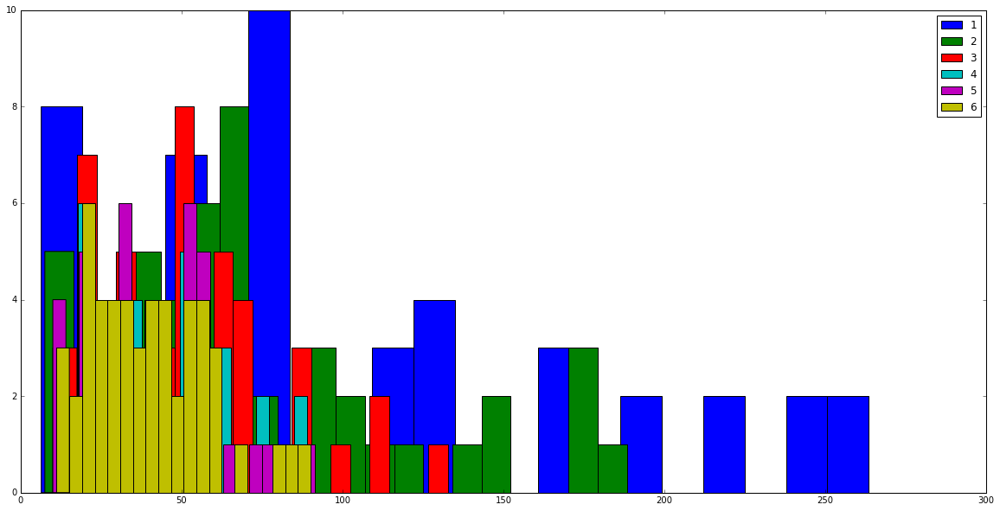

In [53]:
ed = np.array(ed)
ed_noise = np.array(ed_noise)

print "Распределение ошибки, при фиттированием многочленом i-ой степени НЕзашумленных данных"
plt.figure(figsize = (20, 10))
for i in range(MAX_POWER):
    plt.hist(ed[:,i], bins=20, label=str(i+1))
    print i+1, "- min:", min(ed[:,i]), "- max:", max(ed[:,i]), "- mean:", np.mean(ed[:,i])
plt.legend()
plt.show()

print "Распределение ошибки, при фиттированием многочленом i-ой степени зашумленных данных"
plt.figure(figsize = (20, 10))
for i in range(MAX_POWER):
    plt.hist(ed_noise[:,i], bins=20, label=str(i+1))
    print i+1, "- min:", min(ed_noise[:,i]), "- max:", max(ed_noise[:,i]), "- mean:", np.mean(ed_noise[:,i])
plt.legend()
plt.show()

Распределение коэффициентов многочлена при фиттировнии многочленом 1 -ой степени:


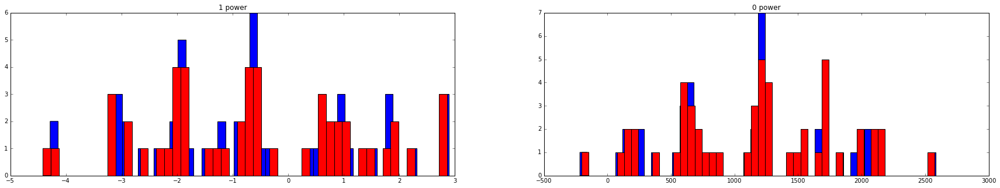

Распределение коэффициентов многочлена при фиттировнии многочленом 2 -ой степени:


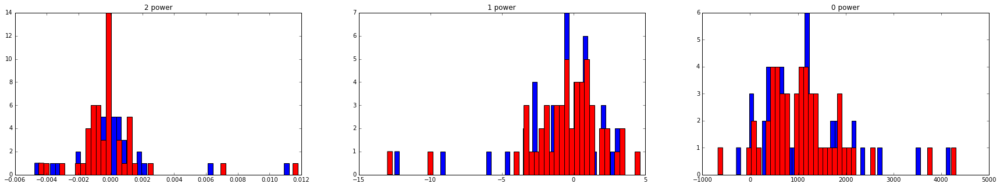

Распределение коэффициентов многочлена при фиттировнии многочленом 3 -ой степени:


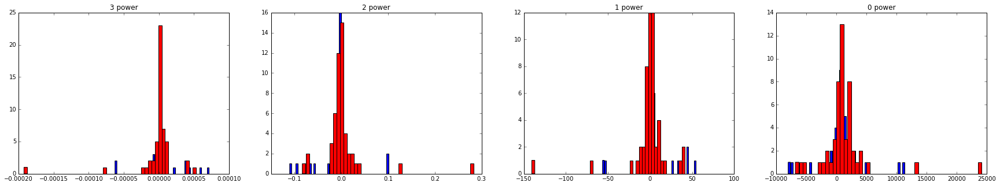

Распределение коэффициентов многочлена при фиттировнии многочленом 4 -ой степени:


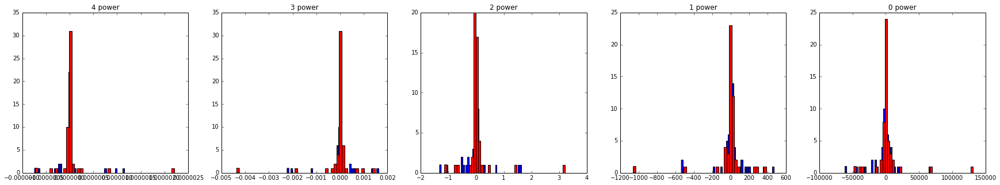

Распределение коэффициентов многочлена при фиттировнии многочленом 5 -ой степени:


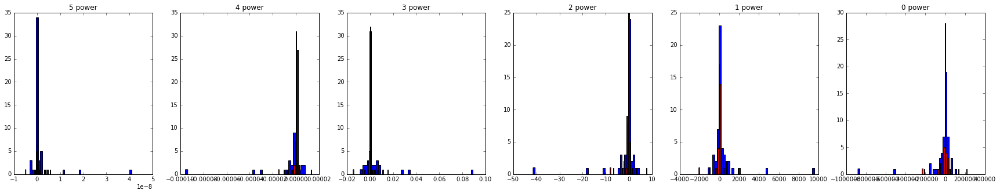

Распределение коэффициентов многочлена при фиттировнии многочленом 6 -ой степени:


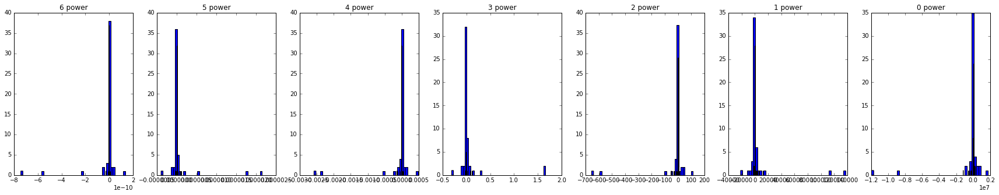

In [54]:
coef = np.array(coef)
coef_noise = np.array(coef_noise)

k=0
for i in range(1, MAX_POWER+1):
    print "Распределение коэффициентов многочлена при фиттировнии многочленом", i, "-ой степени:"
    plt.figure(figsize = (30, 5))
    for j in range(1, i+2):
        plt.subplot(1, i+1, j)
        plt.hist(coef_noise[:,k], bins=50, color='b')
        plt.hist(coef[:,k], bins=50, color='r')
        plt.title(str(i-j+1)+' power')
        k+=1
    plt.show()

## Референсную линия получить не удалось для:

In [29]:
dataBad = json.load(open("data/dataBad.json"))

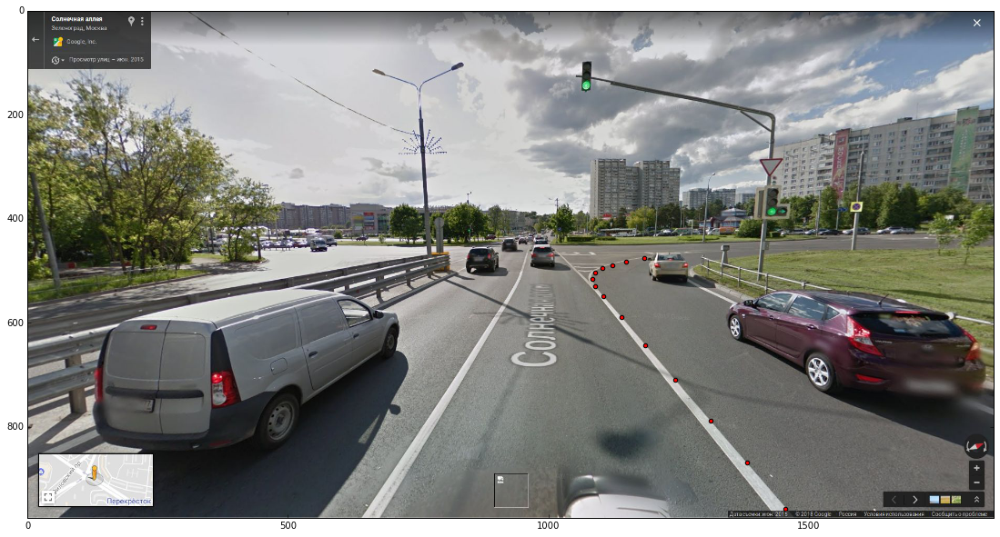

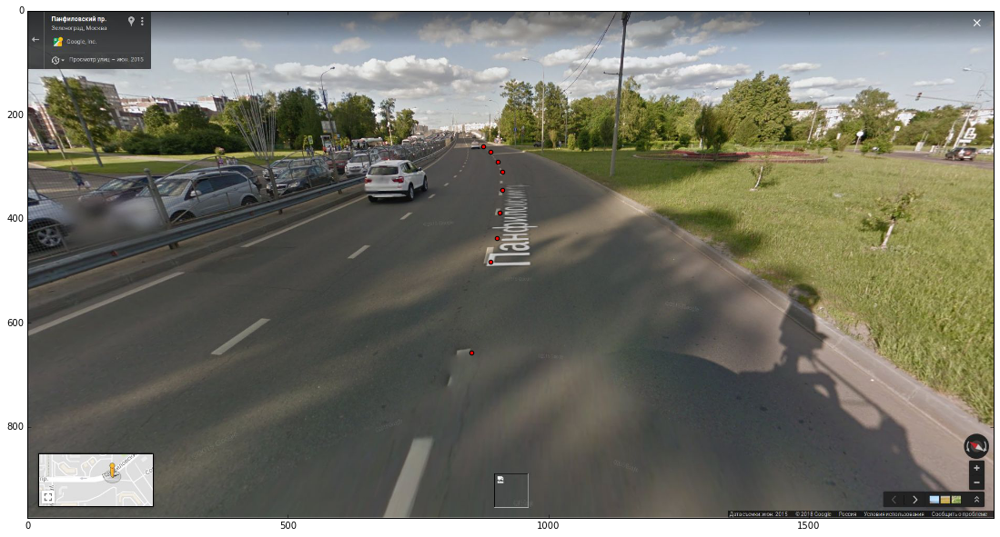

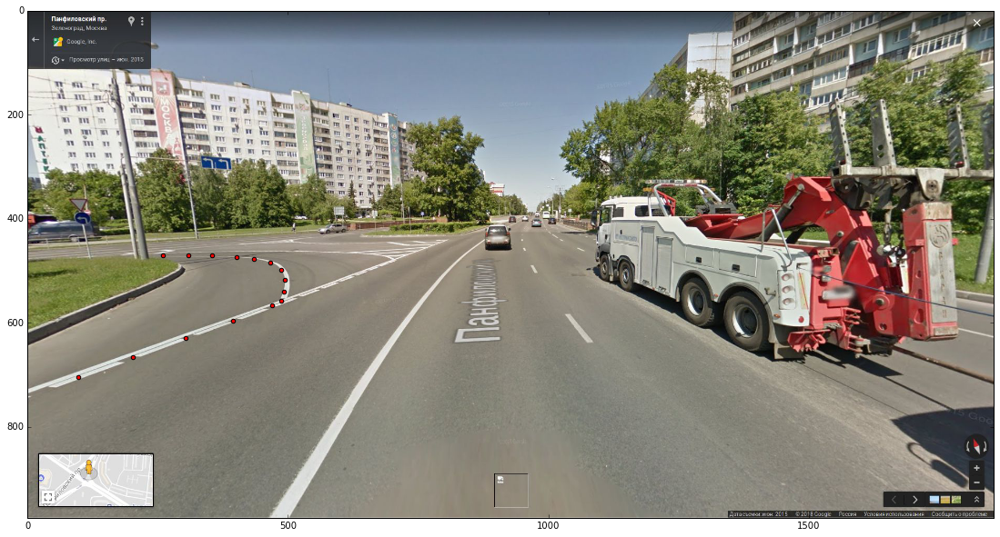

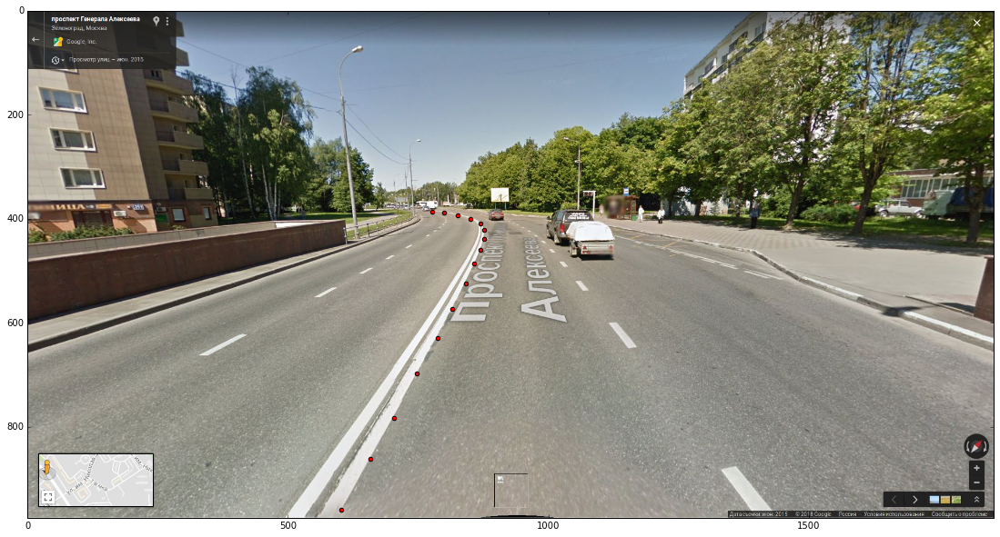

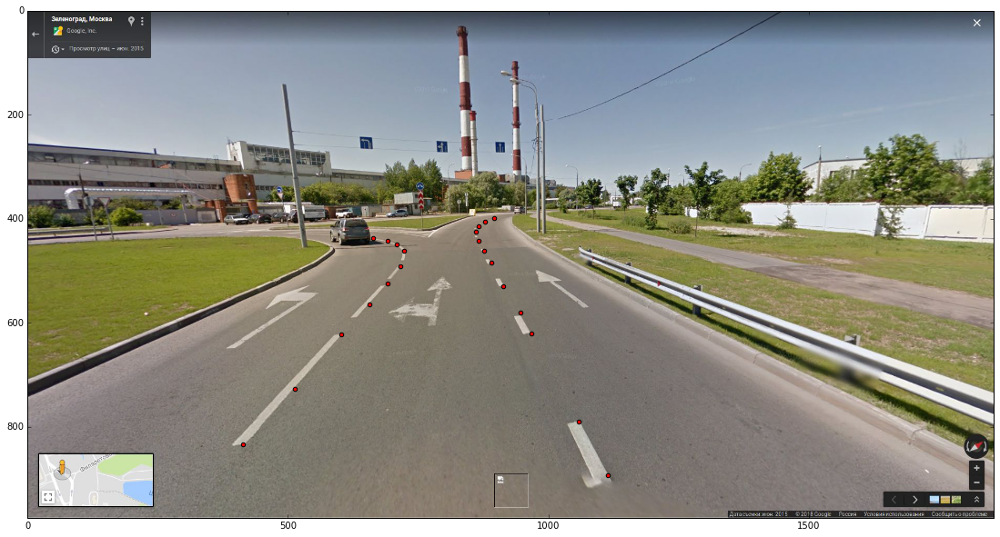

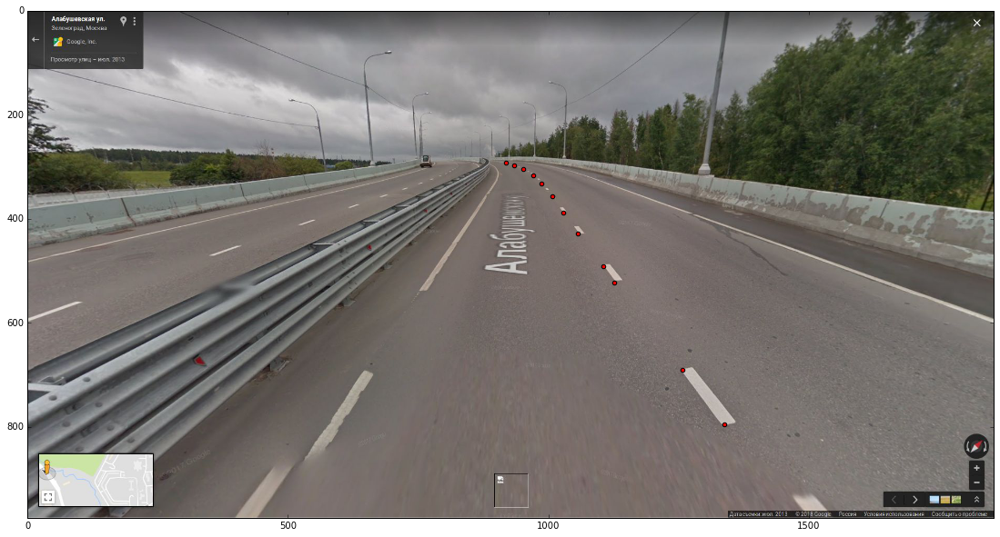

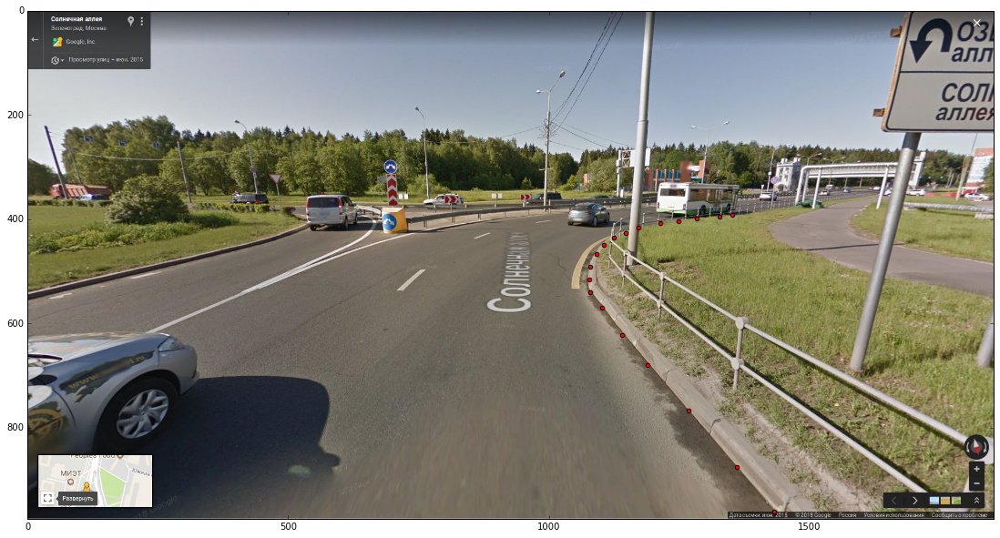

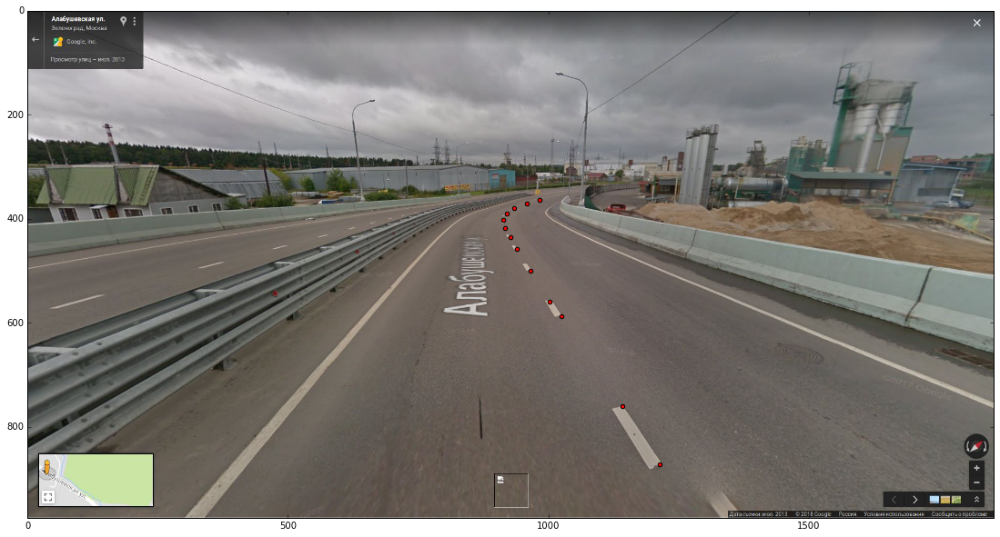

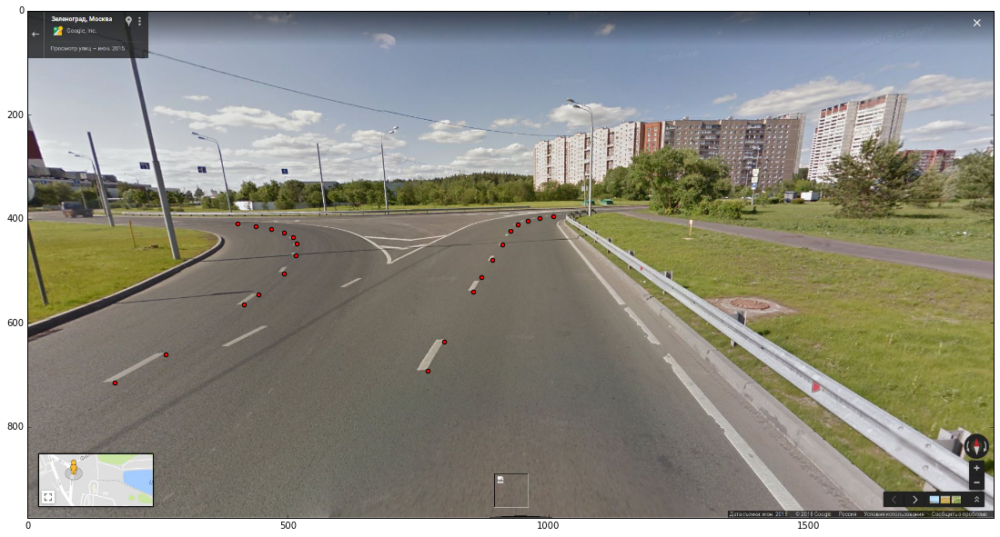

In [48]:
for name in dataBad:
    #отрисовка картинки
    image = scipy.ndimage.imread(name[:-5]+'.jpeg')
    plt.figure(figsize = (25, 10))
    plt.xlim((0, image.shape[1]))
    plt.ylim((image.shape[0], 0))
    plt.imshow(image)
    
    #отрисовка линий
    for line in np.array(dataBad[name]):
        line = np.array(line)
        plt.scatter(line[:,0], line[:,1], c='r')
    plt.show()